In [23]:
from scipy import sparse


In [24]:
import pandas as pd

In [27]:
# Import glob for filename pattern matching
import glob

folder_path = "h-and-m-personalized-fashion-recommendations/images/011"
extension = "*.jpg"

# Use glob to match the pattern 'extension', and find all the pathnames
image_files = glob.glob(f"{folder_path}/{extension}")

# Print each found pathname
for image_file in image_files:
    print(image_file)

/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/0112679048.jpg
/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/0111609001.jpg
/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/0111565003.jpg
/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/0111565001.jpg
/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/0111586001.jpg
/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/0114428026.jpg
/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/0118458039.jpg
/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/0118458004.jpg
/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/0118458038.jpg
/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/011/01144

In [28]:
import os

base_folder = "h-and-m-personalized-fashion-recommendations/images"
extension = "*.jpg"

# Get a list of all subdirectories within the base folder
subdirectories = [folder for folder in os.listdir(base_folder) if os.path.isdir(os.path.join(base_folder, folder))]

all_image_files = []

# Loop over each subdirectory
for subdirectory in subdirectories:
    folder_path = os.path.join(base_folder, subdirectory)
    # Use glob to get all image files in subdirectory
    image_files = glob.glob(os.path.join(folder_path, extension))
    # Append the files in the current subdirectory to the list
    all_image_files.append(image_files)
    

# Show all image files
all_image_files

[['/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/024/0249136006.jpg',
  '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/024/0244267027.jpg',
  '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/024/0244267032.jpg',
  '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/024/0240670058.jpg',
  '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/024/0241436001.jpg',
  '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/024/0249136011.jpg',
  '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/024/0241590001.jpg',
  '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/024/0240840032.jpg',
  '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/024/0244269020.jpg',
  '/Users/muhammadluay/Downloads/h-and-m-perso

In [29]:
# Flatten the list of lists (all_image_files) into a single list (flattened_list)
flattened_list = [file for sublist in all_image_files for file in sublist]

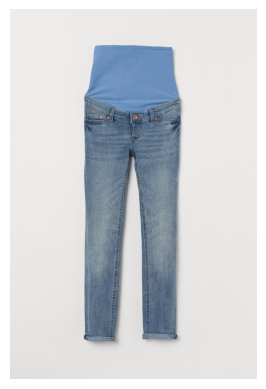

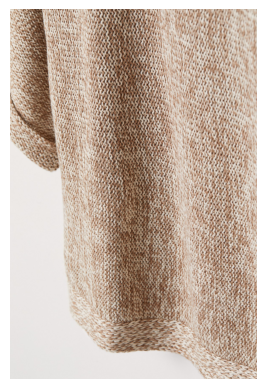

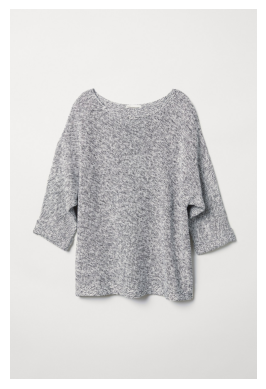

In [30]:
# Import matplotlib for creating static, animated, and interactive visualizations in Python
# Import Image from PIL (Python Imaging Library) for opening, manipulating, and saving many different image file formats
import matplotlib.pyplot as plt
from PIL import Image

# Loop over the first 3 images in the flattened list
for x in flattened_list[:3]:
    # Load the image file
    image = Image.open(x)

    # Display the image using matplotlib
    plt.imshow(image)
    plt.axis('off')  # Turn off axes
    plt.show()

In [37]:
# Import necessary libraries for deep learning and image recognition
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.models import Model
import numpy as np
from sklearn.neighbors import NearestNeighbors


# Load the pre-trained ResNet50 model
base_model = ResNet50(weights='imagenet')
# Construct a Model, by taking base_model.input as input and outputting the 'avg_pool' layer of the base_model
model = Model(inputs=base_model.input, outputs=base_model.get_layer('avg_pool').output)

# Function to extract features from an image
def get_image_features(image_path):
    # Load image, resize to 224x224 pixels, convert to numpy array
    img = image.load_img(image_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)  # Preprocess the image
    features = model.predict(x)  # Get the features of the image
    return features[0]

In [38]:
# Assume a list of image paths
image_paths = flattened_list[:10000]

In [39]:

# Extract features from all images and get labels
data = []
for image_path in image_paths:
    features = get_image_features(image_path)  # Get image features
    label = os.path.basename(image_path)[:3]  # Get label
    data.append({'image_path': image_path, 'features': features, 'label': label})  # Append data to the list

2023-09-08 09:33:27.005352: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 33ms/step


In [40]:
# Convert to DataFrame
data = pd.DataFrame(data)

# Fit a nearest neighbors model
neighbors = NearestNeighbors(n_neighbors=5, algorithm='ball_tree', metric='euclidean')
neighbors.fit(np.stack(data['features'].values))

# Function to find similar images
def get_similar_images(image_path):
    features = get_image_features(image_path)  # Get image features
    distances, indices = neighbors.kneighbors([features])  # Find nearest neighbors for the image
    similar_images = data.iloc[indices[0]]  # Get similar images
    return similar_images

In [41]:
# Get and show columns of similar images
(get_similar_images(image_path)).columns

1/1 [==============================] - 0s 103ms/step


Index(['image_path', 'features', 'label'], dtype='object')

In [42]:
# Get and show image paths of similar images
(((get_similar_images(image_path))['image_path'])).values

1/1 [==============================] - 0s 31ms/step


array(['/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/070/0708107003.jpg',
       '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/079/0797529004.jpg',
       '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/079/0798413002.jpg',
       '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/084/0841185002.jpg',
       '/Users/muhammadluay/Downloads/h-and-m-personalized-fashion-recommendations/images/077/0771005004.jpg'],
      dtype=object)

1/1 [==============================] - 0s 33ms/step


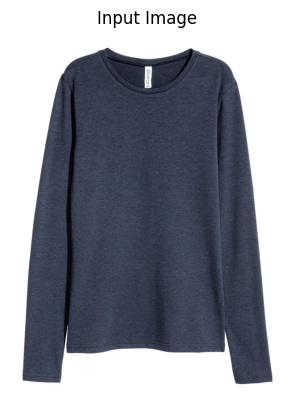

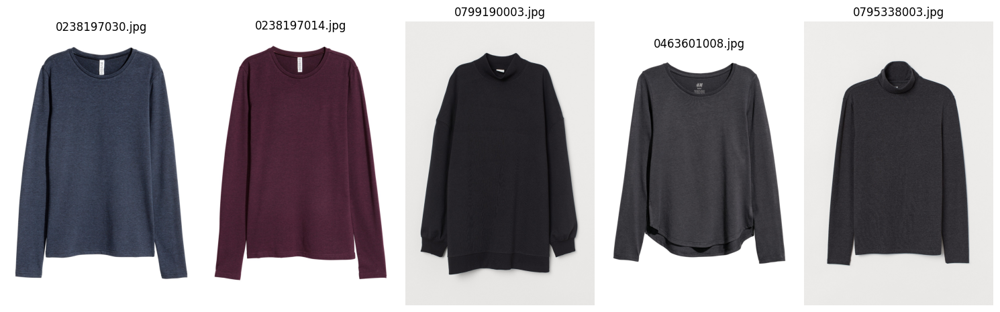

In [43]:
def get_similar_images(input_image_path, neighbors, data, model, num_similar_images=5):
    def get_image_features(image_path):
        img = image.load_img(image_path, target_size=(224, 224))
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = preprocess_input(x)
        features = model.predict(x)
        return features[0]

    features = get_image_features(input_image_path)
    distances, indices = neighbors.kneighbors([features])
    similar_images = data.iloc[indices[0]]

    # Display input image
    img = Image.open(input_image_path)
    plt.imshow(img)
    plt.title("Input Image")
    plt.axis('off')
    plt.show()

    # Display similar images
    fig, axes = plt.subplots(1, num_similar_images, figsize=(15, 5))
    for ax, row in zip(axes, similar_images.iterrows()):
        img_path = row[1]['image_path']
        img = Image.open(img_path)
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(os.path.basename(img_path))
    plt.tight_layout()
    plt.show()

# Test the query function
input_image_path = "/h-and-m-personalized-fashion-recommendations/images/023/0238197030.jpg"
get_similar_images(input_image_path, neighbors, data, model)


1/1 [==============================] - 0s 83ms/step


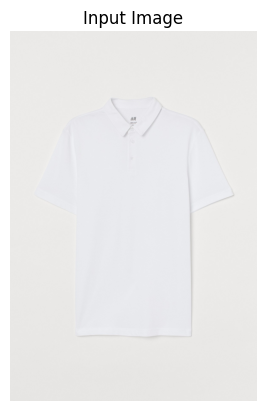

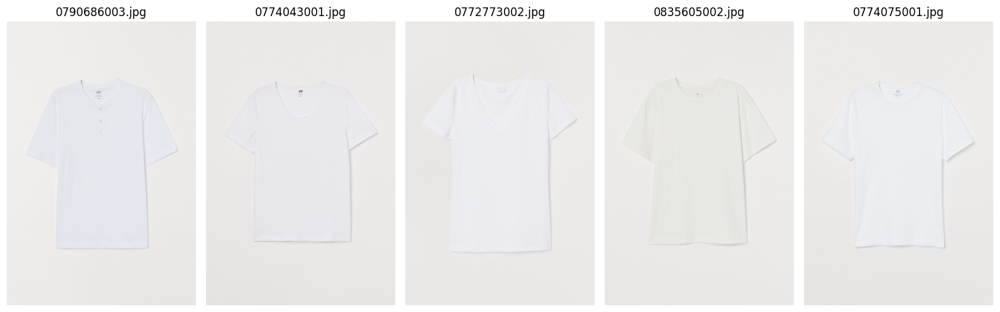

1/1 [==============================] - 0s 29ms/step


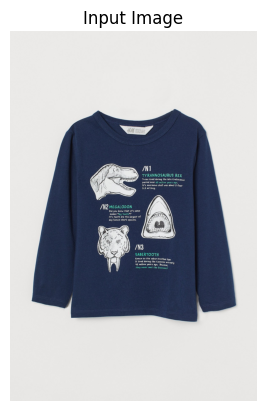

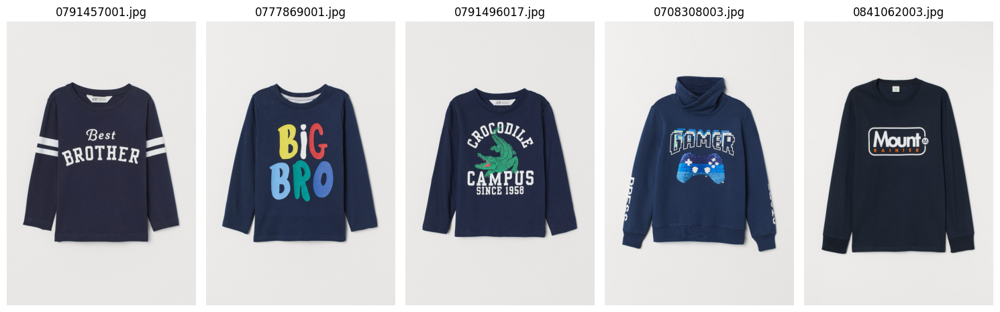

1/1 [==============================] - 0s 35ms/step


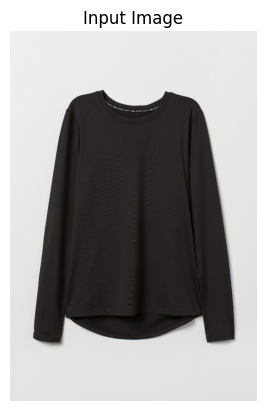

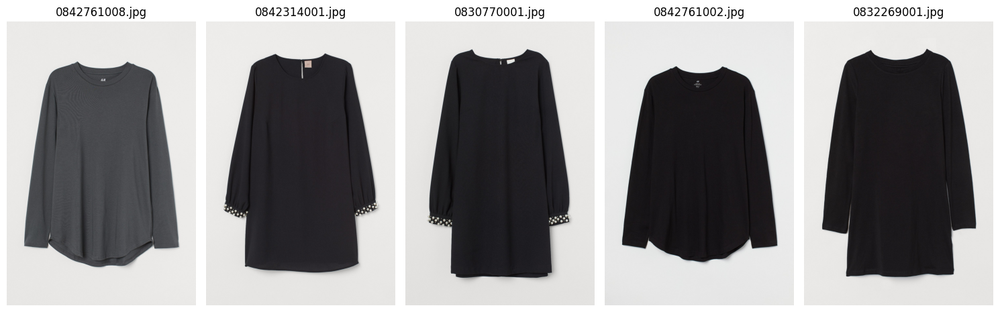

1/1 [==============================] - 0s 32ms/step


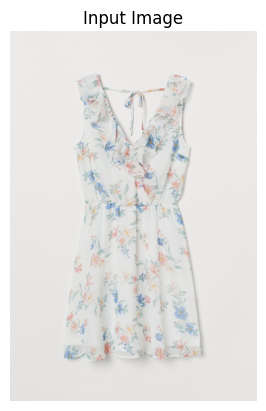

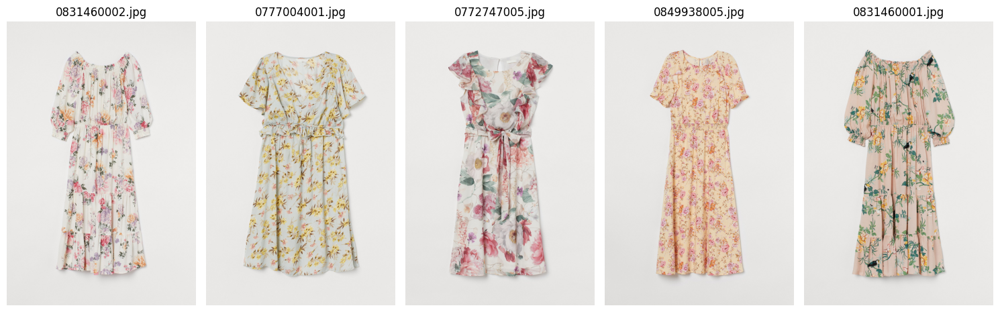

1/1 [==============================] - 0s 31ms/step


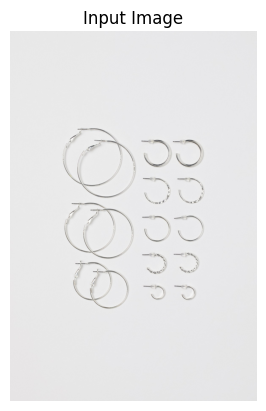

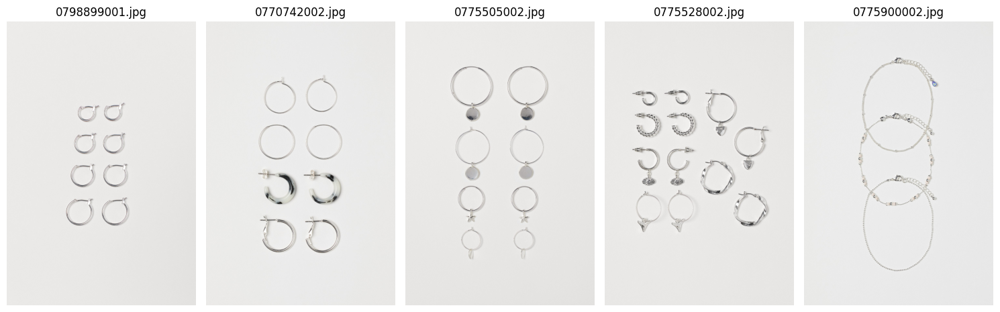

1/1 [==============================] - 0s 43ms/step


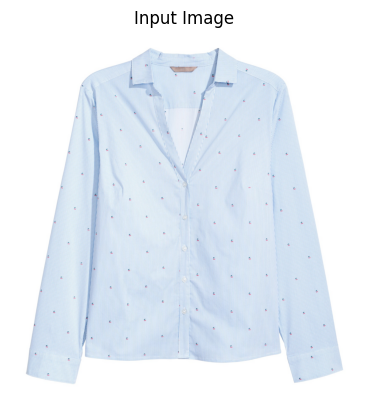

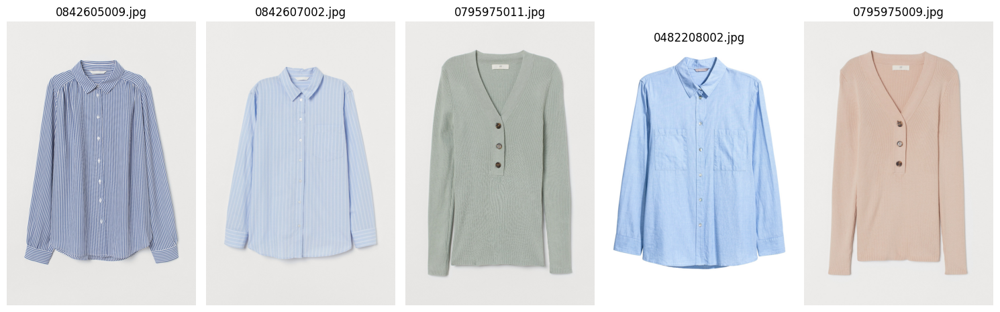

1/1 [==============================] - 0s 33ms/step


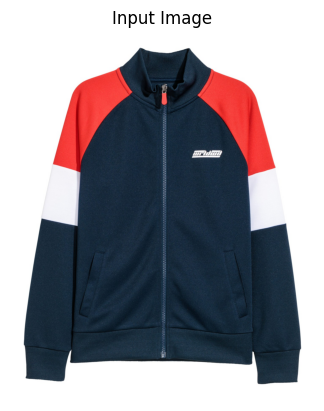

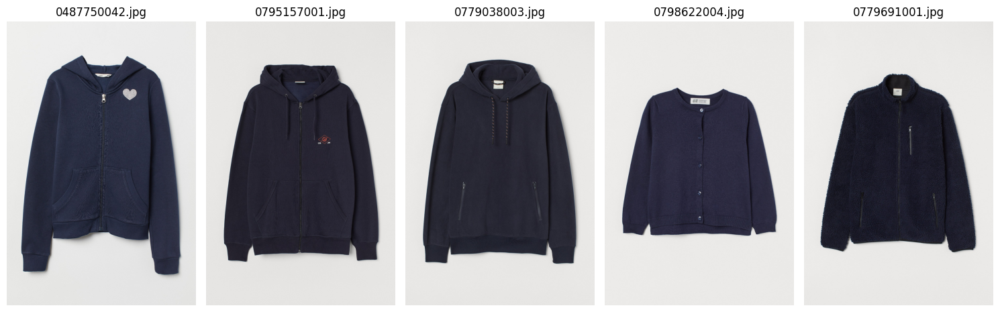

1/1 [==============================] - 0s 33ms/step


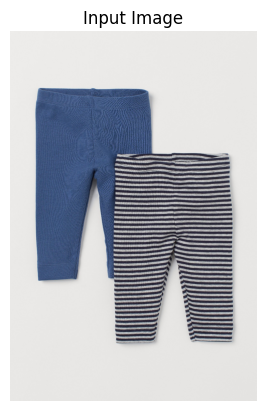

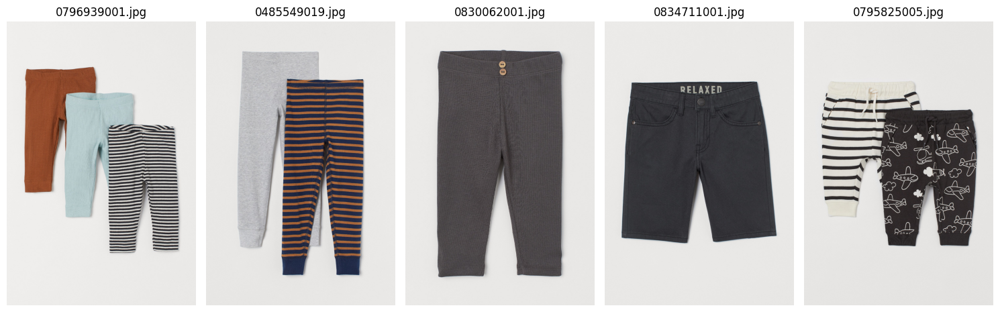

1/1 [==============================] - 0s 36ms/step


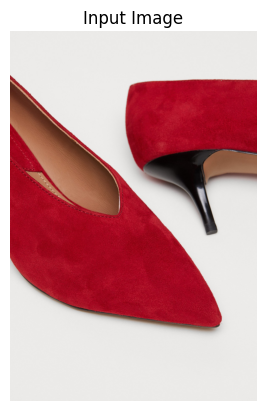

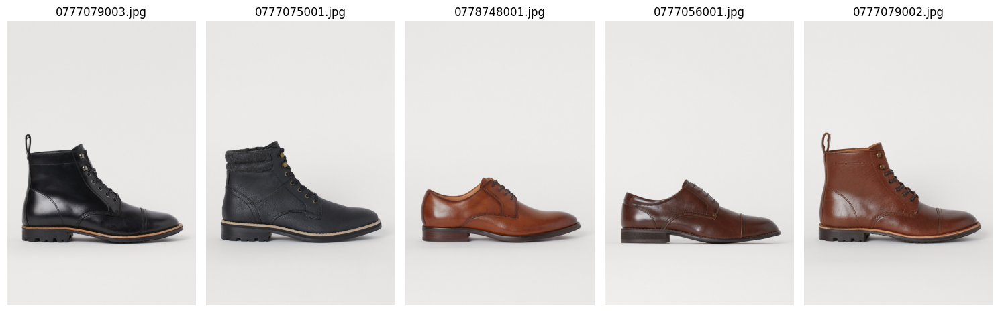

1/1 [==============================] - 0s 39ms/step


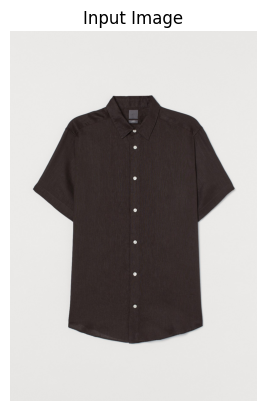

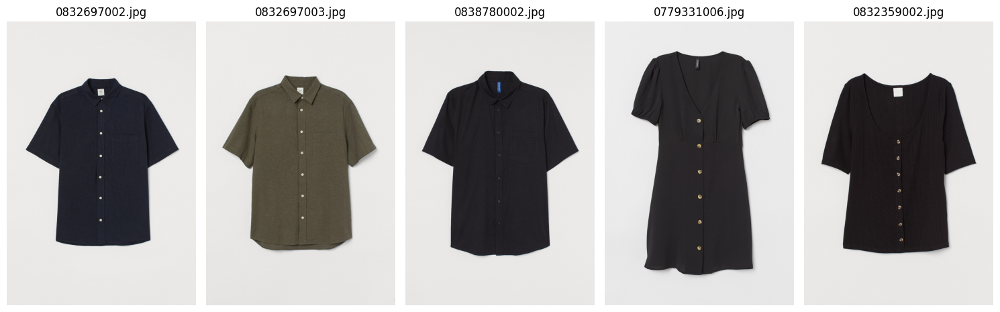

1/1 [==============================] - 0s 68ms/step


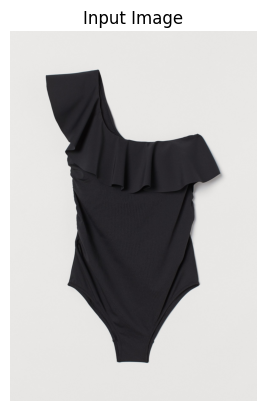

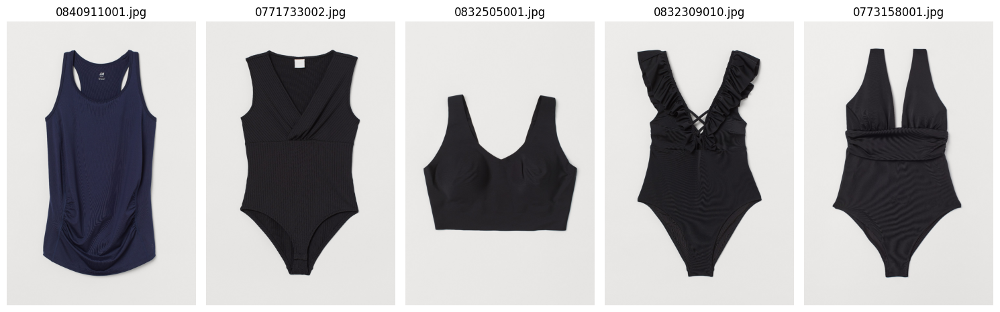

1/1 [==============================] - 0s 52ms/step


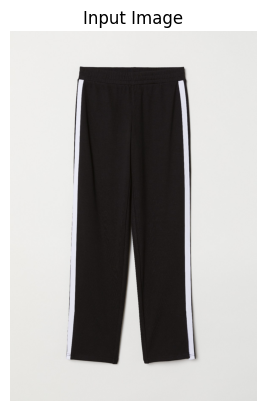

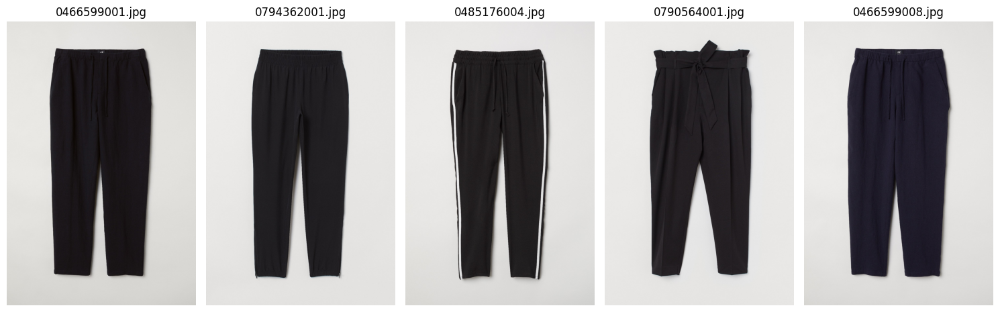

1/1 [==============================] - 0s 33ms/step


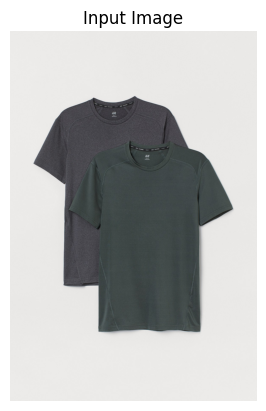

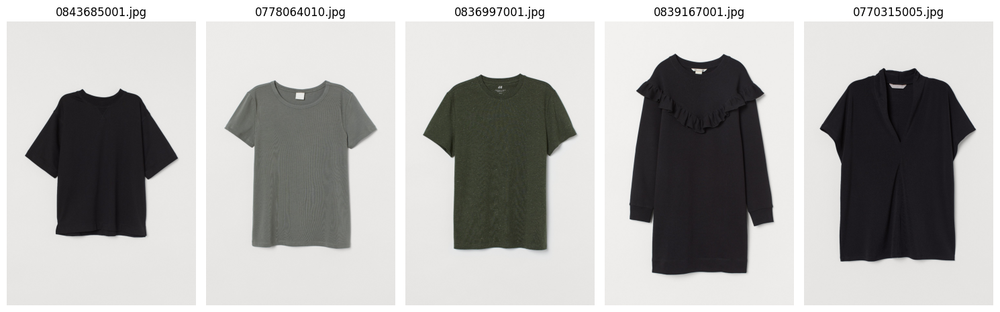

1/1 [==============================] - 0s 42ms/step


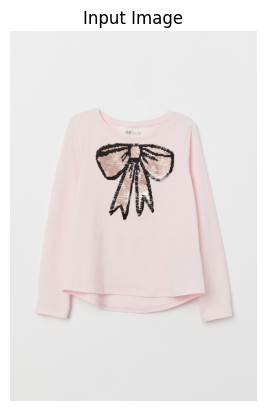

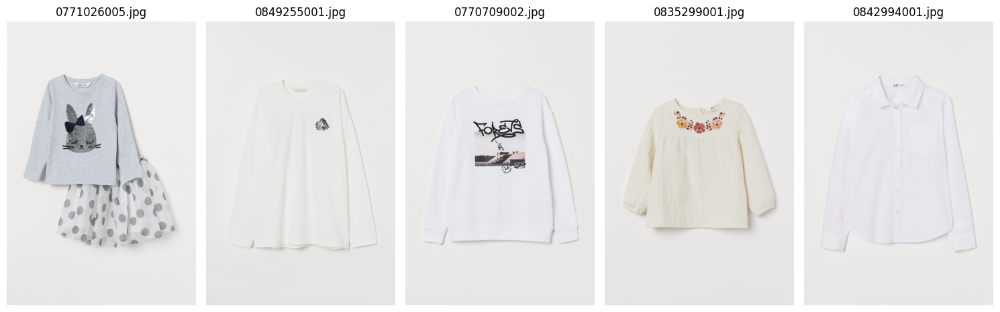

1/1 [==============================] - 0s 45ms/step


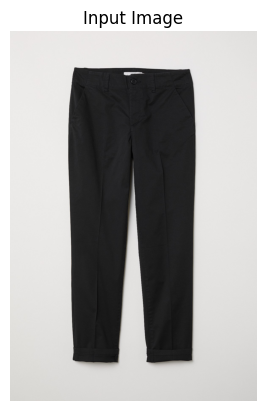

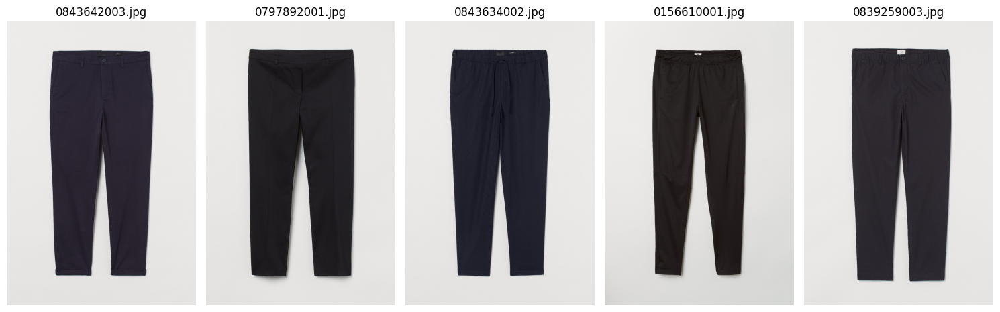

1/1 [==============================] - 0s 51ms/step


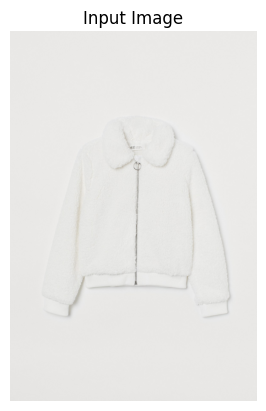

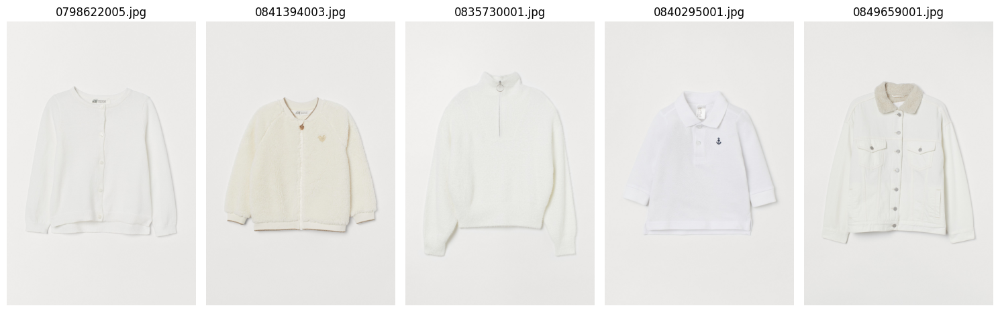

1/1 [==============================] - 0s 84ms/step


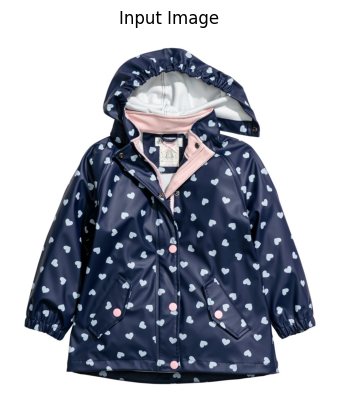

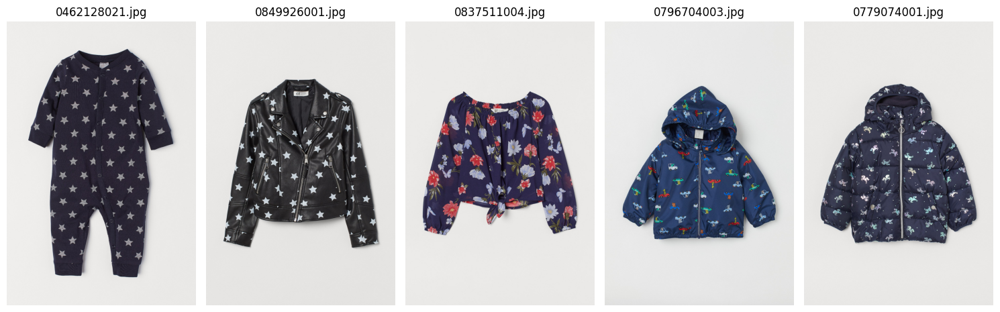

1/1 [==============================] - 0s 87ms/step


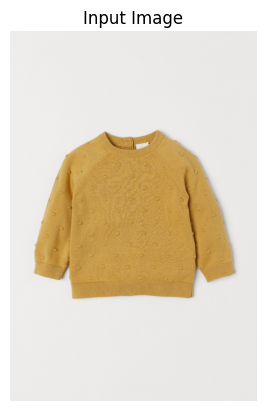

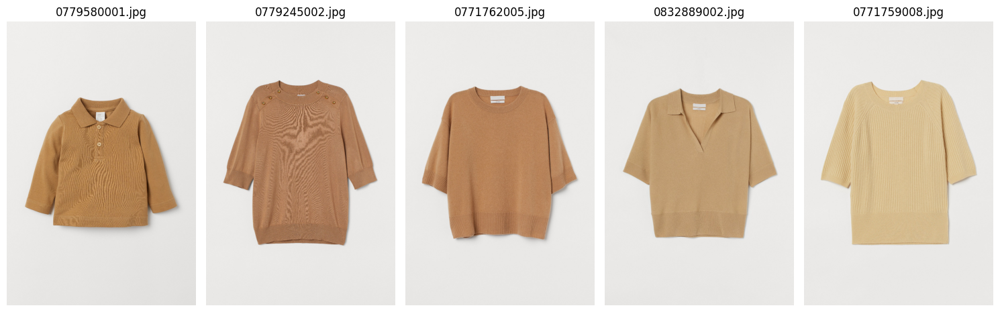

1/1 [==============================] - 0s 67ms/step


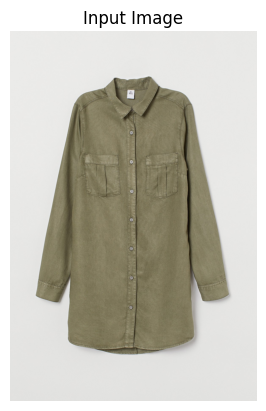

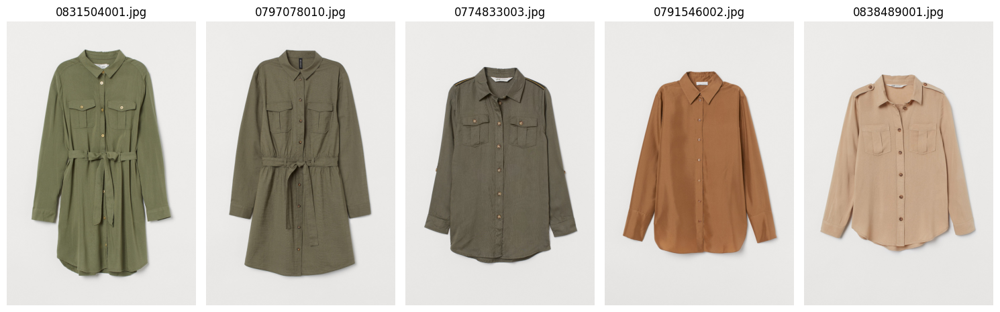

1/1 [==============================] - 0s 64ms/step


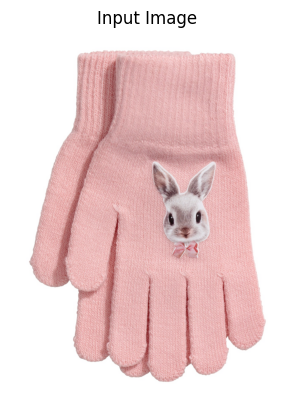

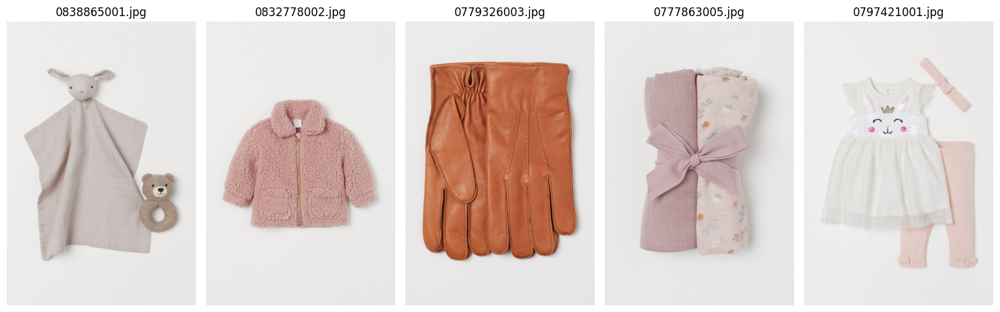

In [44]:
import random

def get_random_similar_images(image_data_folder, neighbors, data, model, num_similar_images=5, num_random_samples=20):
    # Get list of all image paths
    base_folder = os.path.join(image_data_folder, 'images')
    extension = "*.jpg"
    subdirectories = [folder for folder in os.listdir(base_folder) if os.path.isdir(os.path.join(base_folder, folder))]
    all_image_files = []
    for subdirectory in subdirectories:
        folder_path = os.path.join(base_folder, subdirectory)
        image_files = glob.glob(os.path.join(folder_path, extension))
        all_image_files += image_files

    # Sample 10 random images from all_image_files
    random_image_samples = random.sample(all_image_files, num_random_samples)

    for input_image_path in random_image_samples:
        get_similar_images(input_image_path, neighbors, data, model, num_similar_images)

# Test the random sampling function
image_data_folder = "h-and-m-personalized-fashion-recommendations"
get_random_similar_images(image_data_folder, neighbors, data, model)
